# Project:  Create Optimal Hotel Recommendations
# Author: Robert Zacchigna

# Table of Contents

* [Problem Statement](#Problem_Statement)
* [Proposal](#Proposal)
* [Dataset - Expedia Hotel Recommendations](#Dataset)
    * [Columns](#Columns)
* [Imports](#Imports)


* **[Part 1: Exploratory Data Analysis](#Part_1)**
    * [Randomly Sample Dataset (75,000 records) and Drop all Missing (NaN) Values](#Part_1_Rand_Samp)
	* [Merge destination.csv with Sampled train.csv data (on "srch_destination_id" column) and Drop All Missing (NaN) Values](#Part_1-Merge_Data)
	* [Move Target variable (hotel_cluster) to the Front of the Dataset](#Part_1-Move_Target)
	* [Balance the Dataset so that the Target Variable has Equal Records for Each Hotel Cluster](#Part_1-Balance_Data)
	* [Pandas Profiling Report of the Final Balanced Dataset (Without Destination Columns)](#Part_1-Pand_Prof_1)


* **[Part 2: Data Preprocessing and Feature Reduction](#Part_2)**
	* [Convert Date and Time Columns to Datetime dtypes Instead of Strings and then Convert to Datetime Ordinal](#Part_2-Convert_Time)
		* [New Data Types for Each of the Datetime Columns](#Part_2-New_Data_Types)
	* [Use PCA (Principal Component Analysis) to Reduce the Number of Destination Columns in the Dataset](#Part_2-PCA)
		* [Drop Destination Columns from x_train and Append First 10 PCA Components](#Part_2-Drop_Dest_Cols)
	* [Annotated Correlation Matrix of Balanced Data with PCA Components](#Part_2-Corr_Matrix)


* **[Part 3: Model Evaluation and Selection](#Part_3)**
    * [Split Balanced PCA  Dataset into Train and Test Sets](#Part_3-Split_Data)
		* [X_Train Set](#Part_3-X_Train)
		* [Y_Train Set](#Part_3-Y_Train)
	* [Conduct RandomForest Classifier Modeling](#Part_3-Conduct_rf)
		* [Create Pipeline for Scaling and Running RandomForest Classification Modeling](#Part_3-rf_pipe)
		* [Setup Parameters RandomForest Classification Model to be Tested by GridSearchCV](#Part_3-rf_Test_Grid)
		* [Fit Data to RandomForest Grid to Find the Best Parameters for the RandomForest Classification Model](#Part_3-rf_Fit_Grid)
		* [Display Top Accuracy Scores Found by GridSearchCV](#Part_3-rf_Grid_Scores)
		* [From the Dataframe Above, Display the Best Params and Score for the RandomForest Classification Model](#Part_3-rf_params)
	* [Conduct DecisionTree Classification Modeling](#Part_3-Conduct_dt)
		* [Create Pipeline for Scaling and Running DecisionTree Classification Modeling](#Part_3-dt_pipe)
		* [Setup Parameters for DecisionTree Classifier Model to be Tested by GridSearchCV](#Part_3-dt_Test_Grid)
		* [Fit Data to DecisionTree Grid to Find the Best Parameters for the DecisionTree Classification Model](#Part_3-dt_Fit_Grid)
		* [Display Top Accuracy Scores Found by GridSearchCV](#Part_3-dt_Grid_Scores)
		* [From the Dataframe Above, Display the Best Params and Score for the DecisionTree Classifier Model](#Part_3-dt_params)
	* [Compare the Accuracy Scores of Each Model](#Part_3-Compare_Models)
		* [Dataframe of the Accuracy Scores of Both Models (Sorted from Largest to Smallest)](#Part_3-Compare_Acc_Scores)


* **[Part 4: Final Model and Analysis Results](#Part_4)**
    * [Construct Final Model - Random Forest Classifier](#Part_4-Construct_Final_Model)
		* [Display Best Parameters Found by GridSearchCV for the RandomForest Classifier Model](#Part_4-Best_Params)
		* [Create Pipeline for Scaling and Running the Best RandomForest Classifier Model](#Part_4-Final_Pipe)
		* [Fit the Model to the Entire Training Dataset](#Part_4-Final_Fit)
	* [Use RandomForest Classifier Model to Predict the Hotel Clusters on Test Dataset](#Part_4-Predict_Data)
		* [Compare Accuracy Scores of Train Model and Best Model (with Test Data)](#Part_4-Final_Compare_Acc_Scores)
	* [Use RandomForest Classifier Model to Predict Hotel Clusters on the Whole Sampled Dataset](#Part_4-Predict_Whole_Sample_Set)
	* [Analysis Conclusion](#Part_4-Conclusion)

<a id='Problem_Statement'></a>
## Problem Statement

Online travel agencies are scrambling to meet the artificial intelligence driven personalization standard set by companies like Amazon and Netflix. In addition, the world of online travel has become a highly competitive space where brands try to capture our attention (and wallet) with recommending, comparing, matching, and sharing. 

<a id='Proposal'></a>
## Proposal

Create optimal hotel recommendations for Expedia's users that are searching for a hotel to book, specifically predict which "hotel cluster" the user is likely to book, given his (or her) search details. 

Split train.csv into a training and test set (feel free to select a smaller random subset of train.csv). There is another file named destinations.csv, which contains information related to hotel reviews made by users. Then, build at least two prediction models from the training set, and report the accuracies on the test set.

<a id='Dataset'></a>
## Dataset - Expedia Hotel Recommendations

<ins>Download Location:</ins> https://www.kaggle.com/c/expedia-hotel-recommendations/data <a id='Download_Location'></a>

<ins>Columns:</ins><a id='Columns'></a>
* __date_time__ – Timestamp
* __site_name__ – ID of the Expedia point of sale (i.e. Expedia.com, Expedia.co.uk, Expedia.co.jp, ...)
* __posa_continent__ – ID of continent associated with site_name
* __user_location_country__ – The ID of the country the customer is located
* __user_location_region__ – The ID of the region the customer is located
* __user_location_city__ – The ID of the city the customer is located
* __orig_destination_distance__ – Physical distance between a hotel and a customer at the time of search. A null means the distance could not be calculated
* __user_id__ – ID of user
* __is_mobile__ – 1 when a user connected from a mobile device, 0 otherwise
* __is_package__ – 1 if the click/booking was generated as a part of a package (i.e. combined with a flight), 0 otherwise
* __channel__ – ID of a marketing channel
* __srch_ci__ – Checkin date
* __srch_co__ – Checkout date
* __srch_adults_cnt__ – The number of adults specified in the hotel room
* __srch_children_cnt__ – The number of (extra occupancy) children specified in the hotel room
* __srch_rm_cnt__ – The number of hotel rooms specified in the search
* __srch_destination_id__ – ID of the destination where the hotel search was performed
* __srch_destination_type_id__ – Type of destination
* __hotel_continent__ – Hotel continent
* __hotel_country__ – Hotel country
* __hotel_market__ – Hotel market
* __is_booking__ – 1 if a booking, 0 if a click
* __cnt__ – Numer of similar events in the context of the same user session
* __hotel_cluster__ – ID of a hotel cluster
* __srch_destination_id__ – ID of the destination where the hotel search was performed
* __d1-d149__ – latent description of search regions

<a id='Imports'></a>
## Imports

In [1]:
import random
import numpy as np
import pandas as pd
import seaborn as sb
import datetime as dt
import pandas_profiling as pp

from scipy.stats import norm
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, make_scorer
from sklearn.model_selection import train_test_split, GridSearchCV

<a id='Part_1'></a>
# Part 1: Exploratory Data Analysis

<a id='Part_1_Rand_Samp'></a>
## Randomly Sample Dataset (75,000 records) and Drop all Missing (NaN) Values

In [2]:
seed = 42 # set seed

n = sum(1 for line in open(filename)) - 1
s = 75000 # desired sample size

random.seed(seed)
skip = sorted(random.sample(range(1, n + 1), n - s)) # randomly sample dataset

# Read train.csv and drop all missing (NaN) values
hotelData = pd.read_csv('Expedia_Hotel_Data/train.csv', skiprows=skip).dropna().reset_index(drop=True)

In [3]:
print('Dataset shape: {:,} columns and {:,} rows'.format(hotelData.shape[1], hotelData.shape[0]))

Dataset shape: 24 columns and 47,981 rows


In [4]:
hotelData.head()

,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,...,srch_children_cnt,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster
0,2014-08-11 08:24:33,2,3,66,348,48862,2234.2641,12,0,0,...,0,1,8250,1,0,1,2,50,628,1
1,2014-09-22 14:13:18,2,3,66,153,50542,761.0443,15632,0,1,...,1,1,8805,1,0,1,4,8,120,52
2,2014-12-28 12:36:25,2,3,66,220,43026,4703.5435,23234,0,0,...,0,1,8859,1,0,1,2,50,212,55
3,2014-08-13 13:41:21,2,3,66,348,48862,341.2798,23569,0,0,...,0,1,8287,1,0,2,2,198,397,9
4,2014-06-12 07:29:47,11,3,205,354,43201,45.6136,28560,0,0,...,0,1,12951,5,0,1,2,198,397,33


<a id='Part_1-Merge_Data'></a>
## Merge destination.csv with Sampled train.csv data (on "srch_destination_id" column) and Drop All Missing (NaN) Values

In [6]:
destData = hotelData.merge(pd.read_csv('expedia-hotel-recommendations/destinations.csv'), 
                           how='left', on='srch_destination_id').dropna().reset_index(drop=True)

<a id='Part_1-Move_Target'></a>
## Move Target variable (hotel_cluster) to the Front of the Dataset

In [ ]:
tmp = destData['hotel_cluster']

destData = destData.drop(['hotel_cluster'], axis=1)
destData.insert(0, 'hotel_cluster', tmp)

In [7]:
print('Merged Destination Dataset shape: {:,} columns and {:,} rows'.format(destData.shape[1], destData.shape[0]))

Merged Destination Dataset shape: 173 columns and 47,751 rows


In [8]:
destData.head()

,hotel_cluster,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,d140,d141,d142,d143,d144,d145,d146,d147,d148,d149
0,1,2014-08-11 08:24:33,2,3,66,348,48862,2234.2641,12,0,...,-2.384553,-2.345528,-2.396591,-2.399953,-2.388116,-2.394294,-2.400667,-2.398716,-2.386585,-2.390370
1,52,2014-09-22 14:13:18,2,3,66,153,50542,761.0443,15632,0,...,-2.202278,-2.266226,-2.219381,-2.174108,-2.219381,-2.242218,-2.276187,-2.276185,-2.175651,-2.276187
2,55,2014-12-28 12:36:25,2,3,66,220,43026,4703.5435,23234,0,...,-2.323738,-2.250667,-2.299810,-2.144616,-2.193264,-2.233139,-2.351674,-2.338092,-2.351674,-2.116166
3,9,2014-08-13 13:41:21,2,3,66,348,48862,341.2798,23569,0,...,-2.293244,-2.239556,-2.293315,-2.294890,-2.294890,-2.293244,-2.294888,-2.294174,-2.294890,-2.220201
4,33,2014-06-12 07:29:47,11,3,205,354,43201,45.6136,28560,0,...,-2.250248,-2.212484,-2.250323,-2.251294,-2.251294,-2.250248,-2.251293,-2.250853,-2.251294,-2.209588


<a id='Part_1-Balance_Data'></a>
## Balance the Dataset so that the Target Variable has Equal Records for Each Hotel Cluster

In [9]:
balData = destData.groupby('hotel_cluster')
balData = pd.DataFrame(balData.apply(lambda x:
                                     x.sample(balData.size().min()).reset_index(drop=True))).droplevel('hotel_cluster').reset_index(drop=True)

In [10]:
print('Merged Balanced Dataset shape: {:,} columns and {:,} rows'.format(balData.shape[1], balData.shape[0]))

Merged Balanced Dataset shape: 173 columns and 6,500 rows


In [11]:
balData.head()

,hotel_cluster,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,d140,d141,d142,d143,d144,d145,d146,d147,d148,d149
0,0,2014-08-07 17:45:07,2,3,66,363,43253,4674.7903,912617,1,...,-2.318421,-2.044013,-2.258347,-2.166991,-2.282826,-2.298343,-2.324200,-2.304206,-2.317755,-2.283796
1,0,2014-01-25 15:59:37,11,3,205,135,56436,3391.4914,602160,0,...,-2.311260,-2.086433,-2.296965,-2.224663,-2.340364,-2.257228,-2.340607,-2.329235,-2.340607,-2.099513
2,0,2014-12-28 01:24:12,2,3,66,462,49272,1061.1388,79679,0,...,-2.253602,-2.281995,-2.285591,-2.196569,-2.237026,-2.256944,-2.254439,-2.279294,-2.290197,-2.031203
3,0,2014-12-12 20:57:39,2,3,66,442,47582,2168.1149,316597,0,...,-2.263954,-2.252633,-2.281117,-2.307805,-2.313573,-2.279911,-2.313964,-2.306305,-2.235204,-2.311443
4,0,2014-05-14 18:00:14,2,3,66,174,31320,2577.7681,97317,0,...,-2.323738,-2.250667,-2.299810,-2.144616,-2.193264,-2.233139,-2.351674,-2.338092,-2.351674,-2.116166


<a id='Part_1-Pand_Prof_1'></a>
## Pandas Profiling Report of the Final Balanced Dataset (Without Destination Columns)

In [97]:
pp.ProfileReport(balData[balData.columns[:24]]).to_notebook_iframe()

<a id='Part_2'></a>
# Part 2: Data Preprocessing and Feature Reduction 

<a id='Part_2-Convert_Time'></a>
## Convert Date and Time Columns to Datetime dtypes Instead of Strings and then Convert to Datetime Ordinal

In [12]:
for col in ['srch_ci', 'srch_co']:
    balData[col] = pd.to_datetime(balData[col], format = '%Y-%m-%d')
    balData[col] = balData[col].map(dt.datetime.toordinal)

balData['date_time'] = pd.to_datetime(balData['date_time'], format = '%Y-%m-%dT%H:%M:%S')
balData['date_time'] = balData['date_time'].map(dt.datetime.toordinal)

<a id='Part_2-New_Data_Types'></a>
### New Data Types for Each of the Datetime Columns

In [13]:
for col in ['date_time', 'srch_ci', 'srch_co']:
    print('Column: ' + col + ', Type: ' + str(type(balData[col][0])))

Column: date_time, Type: <class 'numpy.int64'>
Column: srch_ci, Type: <class 'numpy.int64'>
Column: srch_co, Type: <class 'numpy.int64'>


In [14]:
balData[['date_time', 'srch_ci', 'srch_co']]

,date_time,srch_ci,srch_co
0,735452,735465,735472
1,735258,735291,735298
2,735595,735628,735630
3,735579,735620,735630
4,735367,735367,735370
...,...,...,...
6495,735070,735298,735300
6496,735314,735346,735350
6497,735089,735156,735159
6498,735433,735454,735455


<a id='Part_2-PCA'></a>
## Use PCA (Principal Component Analysis) to Reduce the Number of Destination Columns in the Dataset

I will be using PCA feature reduction technique to reduce the number of columns, specifically the destination columns, in the dataset down to a more manageable amount for training models.

Text(0, 0.5, 'Explained Variance')

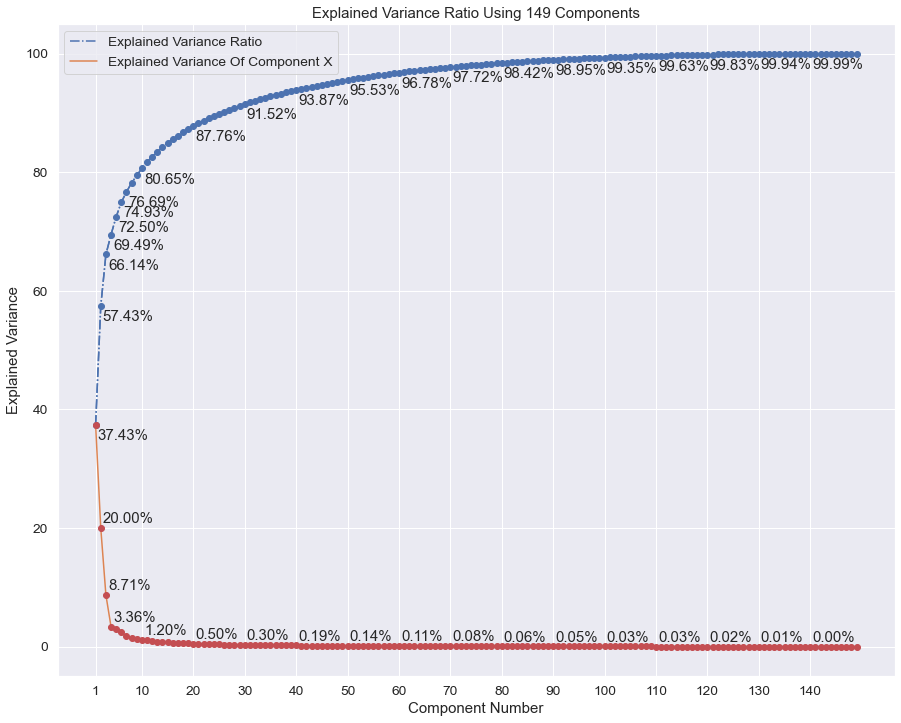

In [15]:
fig = plt.figure()
fig.set_size_inches(15, 12)
sb.set(font_scale = 1.25)

N_COMPONENTS = len(balData.columns[24:])

pca = PCA(n_components = N_COMPONENTS)

pc_matrix = pca.fit_transform(balData[balData.columns[24:]])

evr = pca.explained_variance_ratio_ * 100
cumsum_evr = np.cumsum(evr)

tickMarks = 10

ax = sb.lineplot(x=np.arange(1, len(cumsum_evr) + 1), y=cumsum_evr, label='Explained Variance Ratio')
ax.lines[0].set_linestyle('-.')
ax.set_title('Explained Variance Ratio Using {} Components'.format(N_COMPONENTS))
ax.plot(np.arange(1, len(cumsum_evr) + 1), cumsum_evr, 'bo')

for x, y in zip(range(1, len(cumsum_evr) + 1), cumsum_evr):
    if x in np.arange(1, 8, 1) or x % tickMarks == 0:
        plt.annotate("{:.2f}%".format(y), (x, y), xytext=(2, -15), 
                     textcoords="offset points", annotation_clip = False)

ax = sb.lineplot(x=np.arange(1, len(cumsum_evr) + 1), y=evr, label='Explained Variance Of Component X')
ax.plot(np.arange(1, len(evr) + 1), evr,'ro')
ax.lines[1].set_linestyle('-.')
ax.set_xticks([i for i in range(1, len(cumsum_evr) + 1) if i in np.arange(1, 2, 1) or i % tickMarks == 0])

for x, y in zip(range(1, len(cumsum_evr) + 1), evr):
    if x != 1 and (x in np.arange(1, 5, 1) or x % tickMarks == 0):
        plt.annotate("{:.2f}%".format(y), (x, y), xytext=(2, 5), 
                     textcoords="offset points", annotation_clip = False)

ax.set_xlabel('Component Number')
ax.set_ylabel('Explained Variance')

From the graph above, we can see that of the 149 total components, using only the first 10 will account for almost 81% of the destination column data. As a result, i will be using the first 10 components to explain the destination column data.

<a id='Part_2-Drop_Dest_Cols'></a>
### Drop Destination Columns from x_train and Append First 10 PCA Components

In [16]:
balData = balData[balData.columns[:24]]

bal_PCA_Data = pd.concat([balData, 
                          pd.DataFrame(pc_matrix, columns=['PC-{}'.format(i) for i in range(1, N_COMPONENTS + 1)])], axis=1)

bal_PCA_Data = bal_PCA_Data[bal_PCA_Data.columns[:34]]

In [17]:
print('PCA Balanced Dataset shape: {:,} columns and {:,} rows'.format(bal_PCA_Data.shape[1], bal_PCA_Data.shape[0]))

PCA Balanced Dataset shape: 34 columns and 6,500 rows


In [18]:
bal_PCA_Data.head()

,hotel_cluster,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,PC-1,PC-2,PC-3,PC-4,PC-5,PC-6,PC-7,PC-8,PC-9,PC-10
0,0,735452,2,3,66,363,43253,4674.7903,912617,1,...,0.038359,0.717690,-0.276927,0.574149,0.199952,0.266928,0.041451,-0.423770,0.021183,0.141342
1,0,735258,11,3,205,135,56436,3391.4914,602160,0,...,0.301151,0.744871,-0.574808,0.666642,0.107351,0.158885,0.008331,-0.096678,0.047731,-0.078489
2,0,735595,2,3,66,462,49272,1061.1388,79679,0,...,0.039220,0.266363,-0.237070,0.350676,0.163222,-0.174890,-0.027802,-0.017746,-0.036956,0.049731
3,0,735579,2,3,66,442,47582,2168.1149,316597,0,...,0.275797,0.738823,-0.096367,0.426367,-0.107174,0.072494,0.005108,0.003337,-0.058467,0.147615
4,0,735367,2,3,66,174,31320,2577.7681,97317,0,...,0.263846,0.841132,-0.483993,0.617534,0.179581,0.131722,0.094535,-0.147429,-0.087810,-0.156483


In [19]:
bal_PCA_Data.describe()

,hotel_cluster,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,...,PC-1,PC-2,PC-3,PC-4,PC-5,PC-6,PC-7,PC-8,PC-9,PC-10
count,6500.000000,6500.000000,6500.000000,6500.000000,6500.000000,6500.000000,6500.000000,6500.000000,6.500000e+03,6500.000000,...,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03,6.500000e+03
mean,49.500000,735324.007385,6.259231,2.892308,86.548000,312.011385,27771.486308,2231.990799,6.021436e+05,0.132462,...,-1.246183e-16,4.022765e-16,-1.300840e-16,-2.361188e-16,1.997718e-16,-8.963770e-17,3.235702e-16,-3.733082e-16,1.803685e-16,-1.945794e-16
std,28.868291,204.931858,8.899831,0.580577,54.470165,153.420377,16684.656493,2416.008474,3.415110e+05,0.339018,...,6.878449e-01,5.027686e-01,3.318054e-01,2.059667e-01,1.949011e-01,1.755212e-01,1.489367e-01,1.383939e-01,1.257084e-01,1.231231e-01
min,0.000000,734875.000000,2.000000,0.000000,0.000000,135.000000,3.000000,0.050000,4.000000e+01,0.000000,...,-1.166558e+00,-7.828075e-01,-1.010672e+00,-5.923705e-01,-5.581819e-01,-4.655405e-01,-3.664375e-01,-5.178653e-01,-3.246116e-01,-4.286941e-01
25%,24.750000,735165.000000,2.000000,3.000000,66.000000,174.000000,13951.000000,352.902175,3.134652e+05,0.000000,...,-4.681122e-01,-3.486654e-01,-1.986688e-01,-1.140999e-01,-1.458131e-01,-1.146889e-01,-8.285172e-02,-7.098814e-02,-7.816345e-02,-5.694907e-02
50%,49.500000,735378.000000,2.000000,3.000000,66.000000,318.000000,27117.000000,1303.950450,6.002745e+05,0.000000,...,-1.389363e-01,-1.656830e-01,8.150757e-03,-2.773206e-02,-3.935751e-02,1.865249e-03,-2.881817e-03,-1.116574e-03,-1.644848e-02,1.095536e-03
75%,74.250000,735491.000000,8.000000,3.000000,66.000000,363.000000,42904.750000,3452.731175,8.972692e+05,0.000000,...,2.638461e-01,2.663628e-01,2.265778e-01,1.351711e-01,1.094830e-01,1.077041e-01,6.654613e-02,8.520337e-02,7.095119e-02,6.084757e-02
max,99.000000,735598.000000,40.000000,4.000000,215.000000,1017.000000,56498.000000,11633.559500,1.198685e+06,1.000000,...,2.042211e+00,1.336869e+00,1.047695e+00,6.666419e-01,7.933264e-01,7.877882e-01,8.462339e-01,5.280895e-01,6.852688e-01,6.620767e-01


<a id='Part_2-Corr_Matrix'></a>
## Annotated Correlation Matrix of Balanced Data with PCA Components

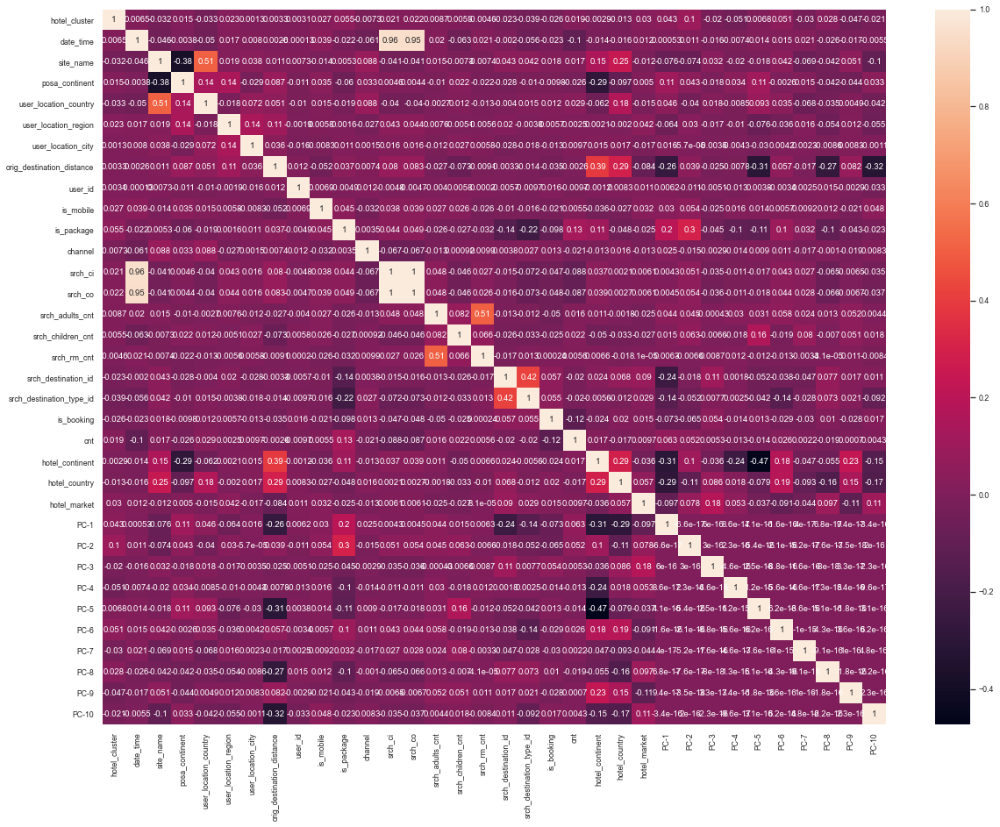

In [20]:
fig = plt.figure()
fig.set_size_inches(20, 15)
sb.set(font_scale = 0.8)

sb.heatmap(bal_PCA_Data.corr('pearson'), annot=True)

<a id='Part_3'></a>
# Part 3: Model Evaluation and Selection

The models I have selected to experiment with in this analysis are the following: Random Forest Classifier and Decision Tree Classifier. The models performances (accuracy Score) with the training data will be compared at the end to see which model performed the best and then the best model will be used as the final model for predicting on the test set.

<a id='Part_3-Split_Data'></a>
## Split Balanced PCA  Dataset into Train and Test Sets

In [21]:
x_train, x_test, y_train, y_test = train_test_split(bal_PCA_Data[bal_PCA_Data.columns[1:]],
                                                    bal_PCA_Data['hotel_cluster'],
                                                    train_size=0.65,
                                                    random_state=seed)

<a id='Part_3-X_Train'></a>
### X_Train Set

In [22]:
print('x_train shape: {:,} columns and {:,} rows'.format(x_train.shape[1], x_train.shape[0]))

x_train shape: 33 columns and 4,225 rows


In [23]:
x_train.head()

,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,...,PC-1,PC-2,PC-3,PC-4,PC-5,PC-6,PC-7,PC-8,PC-9,PC-10
3450,735590,8,4,77,977,53780,4922.0637,460864,0,0,...,-0.702593,-0.127470,0.150997,-0.050624,-0.117820,0.237877,0.071726,-0.105034,0.115129,-0.149392
3142,734914,2,3,66,315,3715,64.1402,51204,0,0,...,-0.898255,-0.122136,0.267205,0.019504,-0.090074,0.072747,0.114866,0.113533,-0.090878,0.159947
1030,735253,2,3,66,448,53078,430.6098,165691,0,0,...,-0.158677,-0.217689,-0.184908,-0.003483,-0.000764,0.065004,-0.044461,-0.100768,0.341342,0.305425
6342,735052,2,3,66,174,16634,2383.6284,324109,0,1,...,0.592609,1.078569,-0.107937,-0.421634,-0.027001,0.038146,-0.094263,0.087668,0.099357,-0.065189
300,735217,2,3,66,348,18146,1185.8921,1037393,0,1,...,0.207330,0.536730,-0.198669,0.183831,0.118125,-0.333120,-0.218281,0.178284,0.092877,-0.013112


In [24]:
x_train.describe()

,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,...,PC-1,PC-2,PC-3,PC-4,PC-5,PC-6,PC-7,PC-8,PC-9,PC-10
count,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4.225000e+03,4225.000000,4225.000000,...,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000,4225.000000
mean,735321.946982,6.161420,2.899408,85.852781,310.261065,27899.190296,2245.810682,5.989017e+05,0.133018,0.255148,...,-0.007904,0.001486,-0.001139,0.000904,0.000370,0.004077,-0.001423,-0.000178,0.000043,0.001363
std,205.936301,8.766812,0.571632,53.927132,154.391940,16788.995787,2426.708839,3.409153e+05,0.339634,0.435996,...,0.680497,0.502323,0.331297,0.204682,0.194835,0.179355,0.147578,0.139207,0.128494,0.125869
min,734875.000000,2.000000,0.000000,0.000000,135.000000,40.000000,0.050000,1.186000e+03,0.000000,0.000000,...,-1.146758,-0.782807,-1.010672,-0.592371,-0.558182,-0.465540,-0.358568,-0.517865,-0.324612,-0.428694
25%,735157.000000,2.000000,3.000000,66.000000,174.000000,13951.000000,354.849800,3.126530e+05,0.000000,0.000000,...,-0.468927,-0.347628,-0.199449,-0.113636,-0.145813,-0.112506,-0.082852,-0.070391,-0.081343,-0.056706
50%,735375.000000,2.000000,3.000000,66.000000,315.000000,27251.000000,1327.180100,5.919250e+05,0.000000,0.000000,...,-0.145545,-0.165683,0.008151,-0.027383,-0.039272,0.008822,-0.003340,-0.000735,-0.019775,0.001861
75%,735490.000000,8.000000,3.000000,66.000000,363.000000,43264.000000,3447.943600,8.949280e+05,0.000000,1.000000,...,0.257810,0.266363,0.227685,0.133614,0.107351,0.113925,0.066100,0.085650,0.068691,0.064014
max,735598.000000,40.000000,4.000000,215.000000,1017.000000,56498.000000,11623.257100,1.198685e+06,1.000000,1.000000,...,2.042211,1.336869,1.047695,0.666642,0.793326,0.787788,0.846234,0.528090,0.685269,0.662077


<a id='Part_3-Y_Train'></a>
### Y_Train Set

In [25]:
print('y_train shape: 1 column and {:,} rows'.format(y_train.shape[0]))

y_train shape: 1 column and 4,225 rows


In [26]:
y_train.head()

3450    53
3142    48
1030    15
6342    97
300      4
Name: hotel_cluster, dtype: int64

In [27]:
y_train.describe()

count    4225.000000
mean       49.943905
std        28.717438
min         0.000000
25%        25.000000
50%        50.000000
75%        75.000000
max        99.000000
Name: hotel_cluster, dtype: float64

<a id='Part_3-Conduct_rf'></a>
## Conduct RandomForest Classifier Modeling

<a id='Part_3-rf_pipe'></a>
### Create Pipeline for Scaling and Running RandomForest Classification Modeling

In [28]:
rf_pipe = Pipeline(steps=([
    ('scale', StandardScaler()),
    ('rf', RandomForestClassifier(random_state=seed))
]))

<a id='Part_3-rf_Test_Grid'></a>
### Setup Parameters RandomForest Classification Model to be Tested by GridSearchCV

In [29]:
param_grid = {'rf__max_depth': [2, 4, 6],
              'rf__class_weight': ['balanced', 'balanced_subsample'],
              'rf__criterion': ['gini', 'entropy'],
              'rf__max_features': ['auto', 'sqrt', 'log2'],
              'rf__min_samples_leaf': [2, 3],
              'rf__min_samples_split': [2, 3],
              'rf__n_estimators': [100, 200]}

rf_grid = GridSearchCV(rf_pipe, scoring=make_scorer(accuracy_score), 
                       param_grid = param_grid, cv = 5, n_jobs = -1, verbose=2)

<a id='Part_3-rf_Fit_Grid'></a>
### Fit Data to RandomForest Grid to Find the Best Parameters for the RandomForest Classification Model

In [30]:
rf_grid.fit(x_train, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    9.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   32.9s
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:  9.6min
[Parallel(n_jobs=-1)]: Done 997 tasks      | elapsed: 14.9min
[Parallel(n_jobs=-1)]: Done 1440 out of 1440 | elapsed: 27.9min finished


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('rf',
                                        RandomForestClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'rf__class_weight': ['balanced', 'balanced_subsample'],
                         'rf__criterion': ['gini', 'entropy'],
                         'rf__max_depth': [2, 4, 6],
                         'rf__max_features': ['auto', 'sqrt', 'log2'],
                         'rf__min_samples_leaf': [2, 3],
                         'rf__min_samples_split': [2, 3],
                         'rf__n_estimators': [100, 200]},
             scoring=make_scorer(accuracy_score), verbose=2)

<a id='Part_3-rf_Grid_Scores'></a>
### Display Top Accuracy Scores Found by GridSearchCV

In [31]:
rf_df = pd.DataFrame(rf_grid.cv_results_).sort_values('mean_test_score', 
                                                      ascending=False)[['params', 'mean_test_score']].head(10)
rf_df

,params,mean_test_score
135,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.110296
143,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.110296
125,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.110296
127,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.110296
133,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.110296
141,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.110296
123,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.109112
129,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.109112
131,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.109112
137,"{'rf__class_weight': 'balanced', 'rf__criterio...",0.109112


<a id='Part_3-rf_params'></a>
### From the Dataframe Above, Display the Best Params and Score for the RandomForest Classification Model

In [33]:
print('Best Random Forest Classification Parameters\n' + '='*44)

for name, val in rf_df.iloc[0]['params'].items():
    print('{:>24}: {}'.format(name.replace('rf__', ''), val))
    
rf_acc = rf_df.iloc[0]['mean_test_score']
print('\nAccuracy Score: {}'.format(round(rf_acc, 4)))

Best Random Forest Classification Parameters
            class_weight: balanced
               criterion: entropy
               max_depth: 6
            max_features: sqrt
        min_samples_leaf: 3
       min_samples_split: 3
            n_estimators: 200

Accuracy Score: 0.1103


<a id='Part_3-Conduct_dt'></a>
## Conduct DecisionTree Classification Modeling

<a id='Part_3-dt_pipe'></a>
### Create Pipeline for Scaling and Running DecisionTree Classification Modeling

In [40]:
dt_pipe = Pipeline(steps=([
    ('scale', StandardScaler()),
    ('dt', DecisionTreeClassifier(random_state=seed))
]))

<a id='Part_3-dt_Test_Grid'></a>
### Setup Parameters for DecisionTree Classifier Model to be Tested by GridSearchCV

In [48]:
param_grid = {'dt__criterion': ['gini', 'entropy'],
              'dt__class_weight': ['balanced', None],
              'dt__splitter': ['best', 'random'],
              'dt__max_features': ['auto', 'sqrt', 'log2'],
              'dt__max_depth': [2, 4, 6],
              'dt__min_samples_leaf': [1, 2, 4],
              'dt__min_samples_split': [2, 4, 6]}

dt_grid = GridSearchCV(dt_pipe, scoring=make_scorer(accuracy_score), 
                       param_grid = param_grid, cv = 5, n_jobs = -1, verbose=2)

<a id='Part_3-dt_Fit_Grid'></a>
### Fit Data to DecisionTree Grid to Find the Best Parameters for the DecisionTree Classification Model

In [49]:
dt_grid.fit(x_train, y_train)

Fitting 5 folds for each of 648 candidates, totalling 3240 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 504 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 1316 tasks      | elapsed:   13.9s
[Parallel(n_jobs=-1)]: Done 2448 tasks      | elapsed:   25.7s
[Parallel(n_jobs=-1)]: Done 3240 out of 3240 | elapsed:   38.4s finished


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('dt',
                                        DecisionTreeClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'dt__class_weight': ['balanced', None],
                         'dt__criterion': ['gini', 'entropy'],
                         'dt__max_depth': [2, 4, 6],
                         'dt__max_features': ['auto', 'sqrt', 'log2'],
                         'dt__min_samples_leaf': [1, 2, 4],
                         'dt__min_samples_split': [2, 4, 6],
                         'dt__splitter': ['best', 'random']},
             scoring=make_scorer(accuracy_score), verbose=2)

<a id='Part_3-dt_Grid_Scores'></a>
### Display Top Accuracy Scores Found by GridSearchCV

In [50]:
dt_df = pd.DataFrame(dt_grid.cv_results_).sort_values('mean_test_score', 
                                                      ascending=False)[['params', 'mean_test_score']].head(10)
dt_df

,params,mean_test_score
596,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077396
594,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077396
630,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077396
612,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077396
614,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077396
632,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077396
600,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077160
620,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077160
638,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077160
602,"{'dt__class_weight': None, 'dt__criterion': 'e...",0.077160


<a id='Part_3-dt_params'></a>
### From the Dataframe Above, Display the Best Params and Score for the DecisionTree Classifier Model

In [51]:
print('Best Decision Tree Classification Parameters\n' + '='*44)

for name, val in dt_df.iloc[0]['params'].items():
    print('{:>23}: {}'.format(name.replace('dt__', ''), val))
    
dt_acc = dt_df.iloc[0]['mean_test_score']
print('\nAccuracy Score: {}'.format(round(dt_acc, 4)))

Best Decision Tree Classification Parameters
           class_weight: None
              criterion: entropy
              max_depth: 6
           max_features: auto
       min_samples_leaf: 1
      min_samples_split: 4
               splitter: best

Accuracy Score: 0.0774


<a id='Part_3-Compare_Models'></a>
## Compare the Accuracy Scores of Each Model

<a id='Part_3-Compare_Acc_Scores'></a>
### Dataframe of the Accuracy Scores of Both Models (Sorted from Largest to Smallest)

In [52]:
acc_scores = [rf_acc, dt_acc]

modelTypes = ['Random Forest Classifier', 'Decision Tree Classifier']

acc_df = pd.DataFrame(zip(modelTypes, acc_scores), columns=['Model Type', 'Accuracy Score'])
acc_df = acc_df.nlargest(len(acc_df), 'Accuracy Score').reset_index(drop=True)

acc_df

,Model Type,Accuracy Score
0,Random Forest Classifier,0.110296
1,Decision Tree Classifier,0.077396


From the above table we can see both models did not have very good accuracy but the Random Forest Classifier did perform the best so that will be the model that i will use to make predictions on the test set for final analysis and results.

<a id='Part_4'></a>
# Part 4: Final Model and Analysis Results

<a id='Part_4-Construct_Final_Model'></a>
## Construct Final Model - Random Forest Classifier

<a id='Part_4-Best_Params'></a>
### Display Best Parameters Found by GridSearchCV for the RandomForest Classifier Model

In [72]:
print('Best Random Forest Classifier Parameters\n' + '='*40)

params = {}

for name, val in rf_df.iloc[0]['params'].items():
    name = name.replace('rf__', '')
    
    params.update({name: val})
    print('{:>21}: {}'.format(name, val))
    
rf_acc = rf_df.iloc[0]['mean_test_score']
print('\nAccuracy Score: {}'.format(round(rf_acc, 4)))

Best Random Forest Classifier Parameters
         class_weight: balanced
            criterion: entropy
            max_depth: 6
         max_features: sqrt
     min_samples_leaf: 3
    min_samples_split: 3
         n_estimators: 200

Accuracy Score: 0.1103


<a id='Part_4-Final_Pipe'></a>
### Create Pipeline for Scaling and Running the Best RandomForest Classifier Model

In [73]:
best_pipe = Pipeline(steps=([
    ('scale', StandardScaler()),
    ('rf', RandomForestClassifier(**params, random_state=seed))
]))

<a id='Part_4-Final_Fit'></a>
### Fit the Model to the Entire Training Dataset

In [74]:
best_model = best_pipe.fit(x_train, y_train)

best_model

Pipeline(steps=[('scale', StandardScaler()),
                ('rf',
                 RandomForestClassifier(class_weight='balanced',
                                        criterion='entropy', max_depth=6,
                                        max_features='sqrt', min_samples_leaf=3,
                                        min_samples_split=3, n_estimators=200,
                                        random_state=42))])

<a id='Part_4-Predict_Data'></a>
## Use RandomForest Classifier Model to Predict the Hotel Clusters on Test Dataset

In [75]:
y_pred = best_model.predict(x_test)

<a id='Part_4-Final_Compare_Acc_Scores'></a>
### Compare Accuracy Scores of Train Model and Best Model (with Test Data)

In [76]:
best_model_score = accuracy_score(y_test, y_pred)

print("Best Random Forest Classifier score using the test data\n" + '='*50 +
      "\nTest Accuracy Score: {}\n\nTrain Accuracy Score: {}".format(round(best_model_score, 4), round(rf_acc, 4)))

print('\nDifference between train and best model test accuracy scores: {}'
      .format(abs(round(best_model_score - rf_acc, 4))))

Best Random Forest Classifier score using the test data
Test Accuracy Score: 0.1156

Train Accuracy Score: 0.1103

Difference between train and best model test accuracy scores: 0.0053


Since the accuracy scores is so close to the value i received during my training experiments, i am confident the model i have selected will perform well with future, unseen, customer hotel data.

<a id='Part_4-Predict_Whole_Sample_Set'></a>
## Use RandomForest Classifier Model to Predict Hotel Clusters on the Whole Sampled Dataset

In [88]:
orginData_PCA_Pred = best_model.predict(bal_PCA_Data[bal_PCA_Data.columns[1:]])

print("Best Random Forest Classifier score using the Whole Sampled Dataset\n" + '='*67 +
      "\nAccuracy Score: {}".format(round(accuracy_score(bal_PCA_Data['hotel_cluster'], orginData_PCA_Pred), 4)))

Best Random Forest Classifier score using the Whole Sampled Dataset
Accuracy Score: 0.2666


<a id='Part_4-Conclusion'></a>
## Analysis Conclusion

The accuracy score for predicting on the entirety of the sampled dataset is roughly double what i got during experimentation, most likely due to the increase in dataset size. The score is still quite bad and would most likely improve with a larger sample size and a different tuned model (and a stronger computer to train the model). I had originally decided to use XGBoost but the model training was taking far too long than what was feasible for me (even with the small sample size) and thus was forced to change to a different model.